### Introduction

 Authors : Su Myat (2403062), Kalai (2403281), Nayli (2403067), Xin Rong (2403192), Zharfan (2402959)

 Class : LAB-P14 Group 3

 Module : INF1002 Programming Fundamentals 
 
 Project : Analyzing U.S. Stock Market Trends
 
 This Jupyter Notebook is focused on analysing the data of 20 US stocks from 2013-01-01 to '2024-08-31'. Then, we used 3 different regression models for prediction modelling.

### 1) Importing Packages

In [44]:
import os
import joblib
import numpy as np
import pandas as pd
import yfinance as yf
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from joblib import Parallel, delayed
from plotly.subplots import make_subplots
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.statespace.sarimax import SARIMAX
from tensorflow.keras.layers import LSTM, Dense, Dropout

### 2) Data Collection


In [45]:
# Define the list of stock tickers
tickers = [
    'AAPL', 'ACN', 'ADBE', 'AMZN', 'AXP', 'C', 'CRM', 'DIS',
    'GOOGL', 'INTC', 'JPM', 'MA', 'META', 'MSFT', 'MU', 'NFLX',
    'NVDA', 'ORCL', 'PYPL', 'V'
]

In [46]:
# Define the date range
start_date = '2013-01-01'
end_date = '2024-08-31'

In [47]:
# Initialize an empty DataFrame to store all the stock data
all_data = pd.DataFrame()

# Loop through each ticker and fetch data
for ticker in tickers:
    #print(f"Fetching data for {ticker}...")
    
    # Download historical data for the current ticker
    data = yf.download(ticker, start=start_date, end=end_date)
    
    # Add a column to the DataFrame for the stock ticker
    data['Ticker'] = ticker
    
    # Append the data to the combined DataFrame
    all_data = pd.concat([all_data, data])

# Reset the index to avoid issues with duplicate dates and tickers
all_data.reset_index(inplace=True)

# Save the combined data to a CSV file
output_file = 'original_combined_stock_data.csv'
all_data.to_csv(output_file, index=False)

print(f"All stock data has been saved to {output_file}")


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

All stock data has been saved to original_combined_stock_data.csv


### 3) Data Exploration

In [48]:
originaldata = pd.read_csv('original_combined_stock_data.csv')
originaldata.head()

,Date,Open,High,Low,Close,Adj Close,Volume,Ticker
0,2013-01-02,19.779285,19.821428,19.343929,19.608213,16.705698,560518000,AAPL
1,2013-01-03,19.567142,19.631071,19.321428,19.360714,16.494835,352965200,AAPL
2,2013-01-04,19.177500,19.236786,18.779642,18.821428,16.035374,594333600,AAPL
3,2013-01-07,18.642857,18.903570,18.400000,18.710714,15.941052,484156400,AAPL
4,2013-01-08,18.900356,18.996071,18.616072,18.761070,15.983954,458707200,AAPL


In [49]:
originaldata.dtypes

Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume         int64
Ticker        object
dtype: object

In [50]:
# Check the unique tickers
print(originaldata['Ticker'].unique())

['AAPL' 'ACN' 'ADBE' 'AMZN' 'AXP' 'C' 'CRM' 'DIS' 'GOOGL' 'INTC' 'JPM'
 'MA' 'META' 'MSFT' 'MU' 'NFLX' 'NVDA' 'ORCL' 'PYPL' 'V']


In [51]:
summary = originaldata.groupby('Ticker')['Close'].describe()
summary

,count,mean,std,min,25%,50%,75%,max
Ticker,,,,,,,,
AAPL,2936.0,79.345946,61.868684,13.947500,28.069375,47.037498,141.710003,234.820007
ACN,2936.0,186.954690,93.325014,68.809998,103.172501,161.504997,279.450012,415.420013
ADBE,2936.0,269.524871,186.864339,37.730000,87.160000,252.809998,439.337494,688.369995
AMZN,2936.0,83.738778,56.366794,12.411500,28.481250,84.742748,133.230000,200.000000
AXP,2936.0,115.024591,44.836378,51.110001,80.042501,99.230003,150.424999,259.839996
C,2936.0,56.701945,10.562398,34.980000,48.189999,53.679998,65.985003,81.910004
CRM,2936.0,140.226848,74.236474,36.750000,72.512499,140.555000,200.760006,316.880005
DIS,2936.0,109.337554,29.064588,50.580002,92.737499,104.814999,117.167503,201.910004
GOOGL,2936.0,70.328156,42.750047,17.589338,35.709500,56.255751,104.379375,191.179993


In [52]:
# Check for missing values
print(originaldata.isnull().sum())

Date         0
Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
Ticker       0
dtype: int64


In [53]:
# Check for duplicate rows
duplicates = originaldata[originaldata.duplicated()]
print(duplicates)

Empty DataFrame
Columns: [Date, Open, High, Low, Close, Adj Close, Volume, Ticker]
Index: []


### 4) Feature Engineering
- Simple Moving Averages (SMA): Broken into 20-day, 50-day, 200-day
- Exponential Moving Averages (EMA): A type of weighted moving average that gives more weight to recent prices
- RSI: To analyze overbought or oversold conditions
- Daily Returns: Useful to track percentage gains/losses
- Volatility: Measures the risk or variability of stock prices, annualized for a clearer picture

(Chen, 2021)

In [54]:
# Function to calculate technical indicators
def calculate_technical_indicators(df):
    # 1. Simple Moving Averages (SMA)
    df['SMA_20'] = df['Close'].rolling(window=20).mean()
    df['SMA_50'] = df['Close'].rolling(window=50).mean()
    df['SMA_200'] = df['Close'].rolling(window=200).mean()

    # 2. Exponential Moving Averages (EMA)
    df['EMA_12'] = df['Close'].ewm(span=12, adjust=False).mean()
    df['EMA_26'] = df['Close'].ewm(span=26, adjust=False).mean()

    # 3. Relative Strength Index (RSI)
    delta = df['Close'].diff(1)
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)
    avg_gain = gain.rolling(window=14).mean()
    avg_loss = loss.rolling(window=14).mean()
    rs = avg_gain / avg_loss
    df['RSI'] = 100 - (100 / (1 + rs))

    # 4. Daily Returns
    df['Daily_Return'] = df['Close'].pct_change()

    # 5. Volatility (Standard Deviation of Daily Returns)
    df['Volatility'] = df['Daily_Return'].rolling(window=21).std() * (252 ** 0.5)  # Annualized volatility
    
    return df

In [55]:
tickers = originaldata['Ticker'].unique()
all_tickers_df = pd.DataFrame()  # Empty dataframe to store all ticker data

for ticker in tickers:
    # Filter data for the specific ticker
    ticker_df = originaldata[originaldata['Ticker'] == ticker].copy()

    # Apply the technical indicators function
    ticker_df = calculate_technical_indicators(ticker_df)

    # Append the ticker_df to the consolidated dataframe
    all_tickers_df = pd.concat([all_tickers_df, ticker_df])

# Step 5: Save the consolidated DataFrame with indicators into a single CSV
all_tickers_df.to_csv('all_tickers_with_indicators.csv')
print("Consolidated CSV saved as 'all_tickers_with_indicators.csv'")

Consolidated CSV saved as 'all_tickers_with_indicators.csv'


In [56]:
dfwithindicators = pd.read_csv('all_tickers_with_indicators.csv')

# Remove unnamed columns
dfwithindicators = dfwithindicators.loc[:, ~dfwithindicators.columns.str.contains('^Unnamed')]

# Save the cleaned DataFrame back to CSV
dfwithindicators.to_csv('all_tickers_with_indicators.csv', index=False)
dfwithindicators.head()

,Date,Open,High,Low,Close,Adj Close,Volume,Ticker,SMA_20,SMA_50,SMA_200,EMA_12,EMA_26,RSI,Daily_Return,Volatility
0,2013-01-02,19.779285,19.821428,19.343929,19.608213,16.705698,560518000,AAPL,NaN,NaN,NaN,19.608213,19.608213,NaN,NaN,NaN
1,2013-01-03,19.567142,19.631071,19.321428,19.360714,16.494835,352965200,AAPL,NaN,NaN,NaN,19.570137,19.589880,NaN,-0.012622,NaN
2,2013-01-04,19.177500,19.236786,18.779642,18.821428,16.035374,594333600,AAPL,NaN,NaN,NaN,19.454951,19.532958,NaN,-0.027855,NaN
3,2013-01-07,18.642857,18.903570,18.400000,18.710714,15.941052,484156400,AAPL,NaN,NaN,NaN,19.340453,19.472051,NaN,-0.005882,NaN
4,2013-01-08,18.900356,18.996071,18.616072,18.761070,15.983954,458707200,AAPL,NaN,NaN,NaN,19.251317,19.419386,NaN,0.002691,NaN


In [57]:
# Check for missing values
print(dfwithindicators.isnull().sum())

Date               0
Open               0
High               0
Low                0
Close              0
Adj Close          0
Volume             0
Ticker             0
SMA_20           380
SMA_50           980
SMA_200         3980
EMA_12             0
EMA_26             0
RSI              260
Daily_Return      20
Volatility       420
dtype: int64


#### Handling Missing Values:

- The null values are expected for the fields above as they require a certain number of prior data points. 
- We chose to fill the missing values with Backward Fill as we are expecting continuity in our data.

(Sujatha Mudadla, 2024)

In [58]:
# Apply backward fill to fill missing values
dfwithindicators.fillna(method='bfill', inplace=True)

# Export the updated DataFrame to a new CSV file
dfwithindicators.to_csv('final_dataset.csv', index=False)

print("Data exported to 'final_dataset.csv'")

C:\Users\smnhw\AppData\Local\Temp\ipykernel_11500\3626940314.py:2: FutureWarning:

DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



Data exported to 'final_dataset.csv'


In [59]:
finaldf = pd.read_csv('final_dataset.csv')
finaldf.head()

,Date,Open,High,Low,Close,Adj Close,Volume,Ticker,SMA_20,SMA_50,SMA_200,EMA_12,EMA_26,RSI,Daily_Return,Volatility
0,2013-01-02,19.779285,19.821428,19.343929,19.608213,16.705698,560518000,AAPL,17.854964,16.736007,16.272721,19.608213,19.608213,29.84149,-0.012622,0.51561
1,2013-01-03,19.567142,19.631071,19.321428,19.360714,16.494835,352965200,AAPL,17.854964,16.736007,16.272721,19.570137,19.589880,29.84149,-0.012622,0.51561
2,2013-01-04,19.177500,19.236786,18.779642,18.821428,16.035374,594333600,AAPL,17.854964,16.736007,16.272721,19.454951,19.532958,29.84149,-0.027855,0.51561
3,2013-01-07,18.642857,18.903570,18.400000,18.710714,15.941052,484156400,AAPL,17.854964,16.736007,16.272721,19.340453,19.472051,29.84149,-0.005882,0.51561
4,2013-01-08,18.900356,18.996071,18.616072,18.761070,15.983954,458707200,AAPL,17.854964,16.736007,16.272721,19.251317,19.419386,29.84149,0.002691,0.51561


In [60]:
# Check for missing values
print(finaldf.isnull().sum())

Date            0
Open            0
High            0
Low             0
Close           0
Adj Close       0
Volume          0
Ticker          0
SMA_20          0
SMA_50          0
SMA_200         0
EMA_12          0
EMA_26          0
RSI             0
Daily_Return    0
Volatility      0
dtype: int64


In [61]:
# for outlier detection
fig = px.box(finaldf, x='Ticker', y='Close', title='Stock Price Distribution and Outliers',
              labels={'Close': 'Closing Price', 'Ticker': 'Stock Ticker'},
              points='all')  # This will show all points, useful for detecting outliers

# Update layout for better visibility
fig.update_layout(xaxis_title='Stock Ticker',
                  yaxis_title='Closing Price',
                  xaxis_tickangle=-45)

# Show the figure
fig.show()

In [62]:
# Convert Date column to datetime format
finaldf['Date'] = pd.to_datetime(finaldf['Date'])

In [63]:
finaldf.dtypes

Date            datetime64[ns]
Open                   float64
High                   float64
Low                    float64
Close                  float64
Adj Close              float64
Volume                   int64
Ticker                  object
SMA_20                 float64
SMA_50                 float64
SMA_200                float64
EMA_12                 float64
EMA_26                 float64
RSI                    float64
Daily_Return           float64
Volatility             float64
dtype: object

### 5) Exploratory Data Analysis

##### 1) Stock Prices Over Time

In [64]:
# Create a figure
fig = go.Figure()

# Loop through each unique ticker and add its closing price to the figure
for ticker in finaldf['Ticker'].unique():
    subset = finaldf[finaldf['Ticker'] == ticker]
    fig.add_trace(go.Scatter(
        x=subset['Date'],  # Use the Date column for the x-axis
        y=subset['Close'],  # Use the Close column for the y-axis
        mode='lines',
        name=ticker,
        hovertemplate=f'Ticker: {ticker}<br>Date: %{{x}}<br>Close: %{{y}}<extra></extra>'
    ))

# Update layout
fig.update_layout(
    title='Stock Closing Prices from 2013 to 2024',
    xaxis_title='Date',
    yaxis_title='Closing Price (USD)',
    legend_title='Ticker',
    template='plotly_white'
)

# Show the figure
fig.show()

d:\AppData\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



##### 2) Daily Returns

In [65]:
# Convert the Date column to datetime format
finaldf['Date'] = pd.to_datetime(finaldf['Date'])

# Create the figure
fig = go.Figure()

# Loop through each unique ticker and add a trace for each
for ticker in finaldf['Ticker'].unique():
    subset = finaldf[finaldf['Ticker'] == ticker]
    fig.add_trace(go.Scatter(
        x=subset['Date'],  # Ensure dates are correctly used here
        y=subset['Daily_Return'],
        mode='lines',
        name=ticker,
        hovertemplate='Ticker: {}<br>Date: %{{x}}<br>Daily Return: %{{y:.2%}}<extra></extra>'.format(ticker)
    ))

# Update layout
fig.update_layout(
    title='Daily Returns for All Tickers (2013-2024)',
    xaxis_title='Date',
    yaxis_title='Daily Return',
    template='plotly_white'
)

# Show the figure
fig.show()

d:\AppData\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



##### 3) Moving Averages

In [66]:
fig = go.Figure()

# Loop through each unique ticker and add traces for each moving average
for ticker in finaldf['Ticker'].unique():
    subset = finaldf[finaldf['Ticker'] == ticker]
    
    # Add 20-day SMA trace
    fig.add_trace(go.Scatter(
        x=subset['Date'],  # Use Date for x-axis
        y=subset['SMA_20'],  # Use SMA_20 for y-axis
        mode='lines',
        name=f'{ticker} 20-day SMA',
        hovertemplate='Ticker: {}<br>Date: %{{x}}<br>20-day SMA: %{{y:.2f}}<extra></extra>'.format(ticker)
    ))
    
    # Add 50-day SMA trace
    fig.add_trace(go.Scatter(
        x=subset['Date'],  # Use Date for x-axis
        y=subset['SMA_50'],  # Use SMA_50 for y-axis
        mode='lines',
        name=f'{ticker} 50-day SMA',
        hovertemplate='Ticker: {}<br>Date: %{{x}}<br>50-day SMA: %{{y:.2f}}<extra></extra>'.format(ticker)
    ))
    
    # Add 200-day SMA trace
    fig.add_trace(go.Scatter(
        x=subset['Date'],  # Use Date for x-axis
        y=subset['SMA_200'],  # Use SMA_200 for y-axis
        mode='lines',
        name=f'{ticker} 200-day SMA',
        hovertemplate='Ticker: {}<br>Date: %{{x}}<br>200-day SMA: %{{y:.2f}}<extra></extra>'.format(ticker)
    ))

# Update layout
fig.update_layout(
    title='Simple Moving Averages for All Tickers (2013-2024)',
    xaxis_title='Date',
    yaxis_title='Moving Average Price (USD)',
    template='plotly_white'
)

# Show the figure
fig.show()

### 6) Modelling

##### Feature Selection
- We plotted correlation matrices to find the correlation of all the different indicators to the Close price.

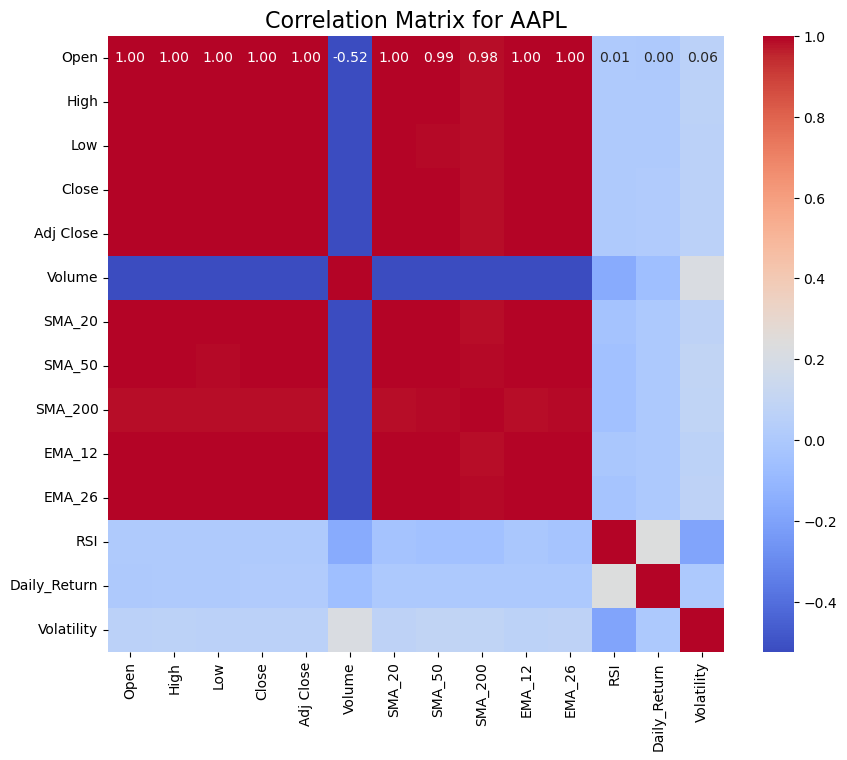

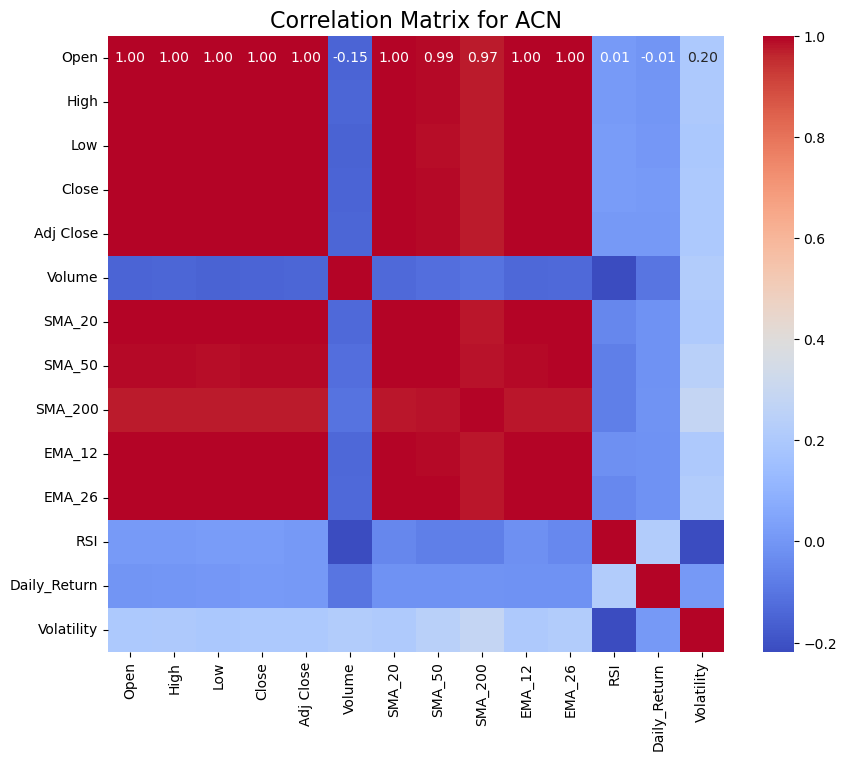

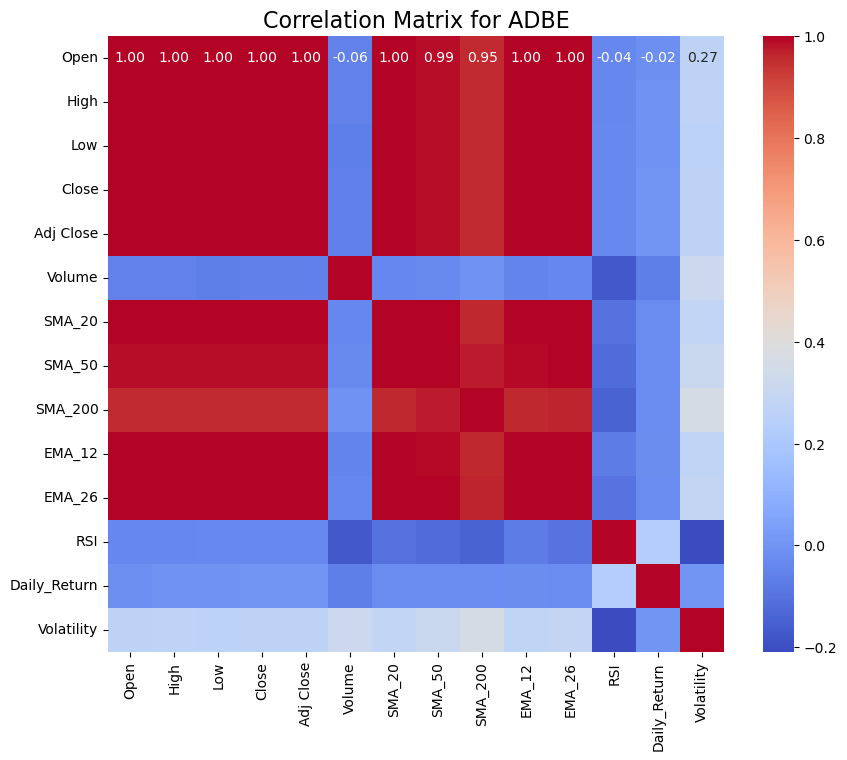

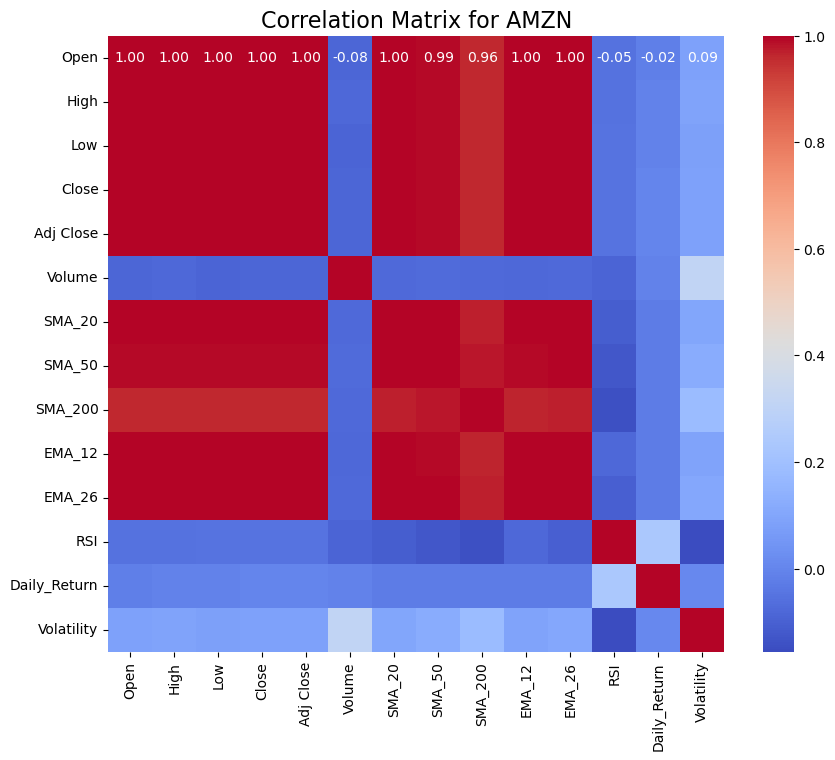

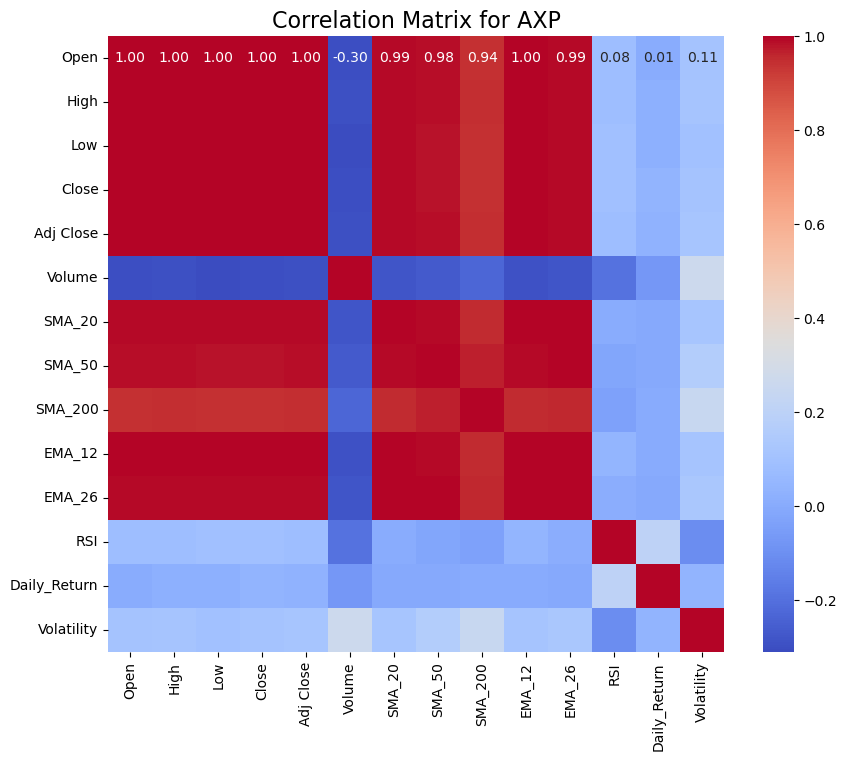

...

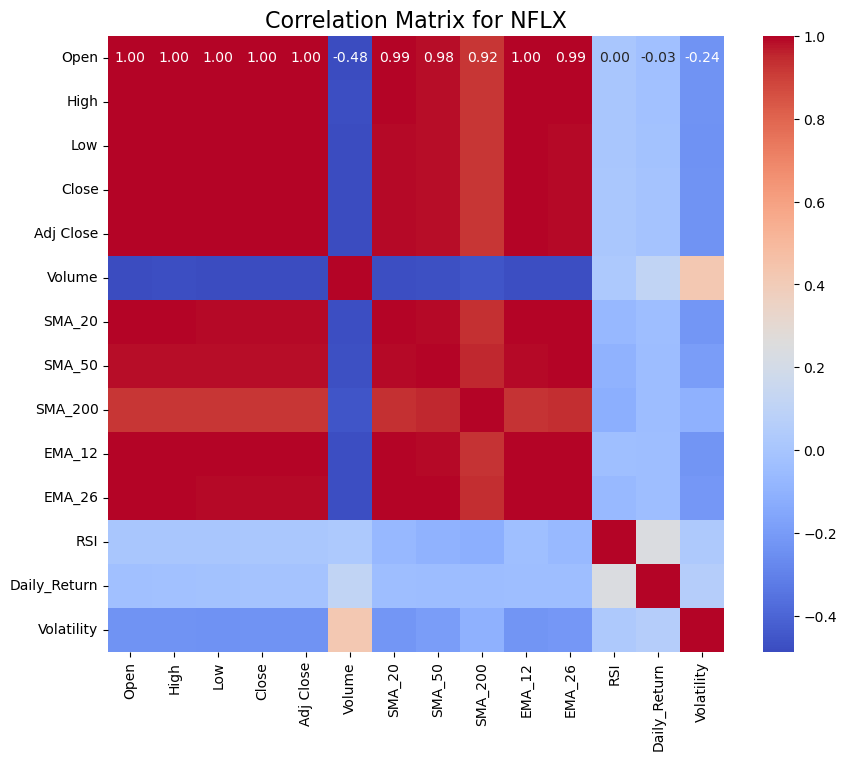

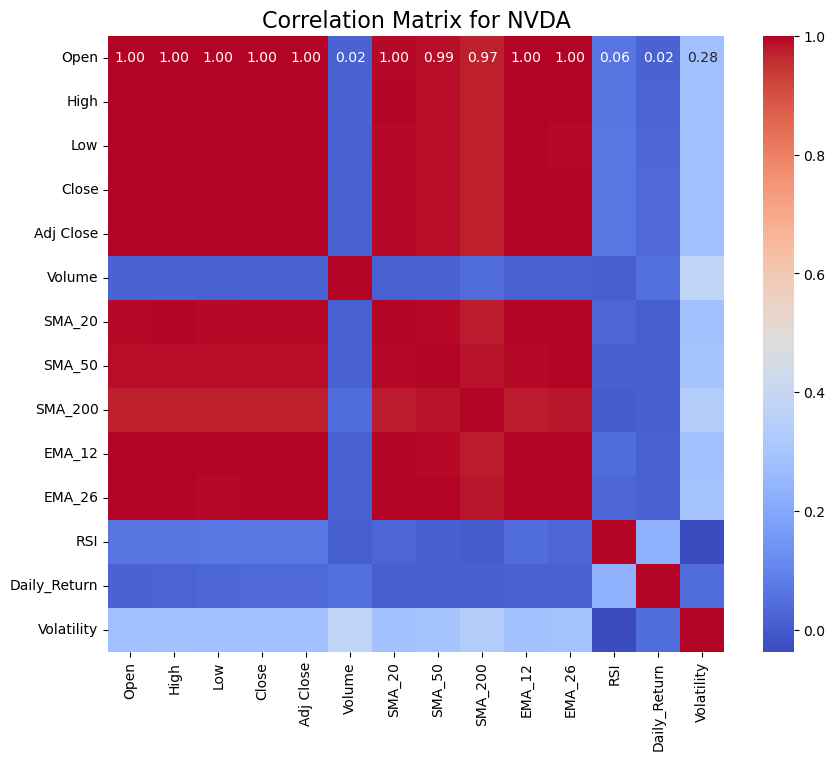

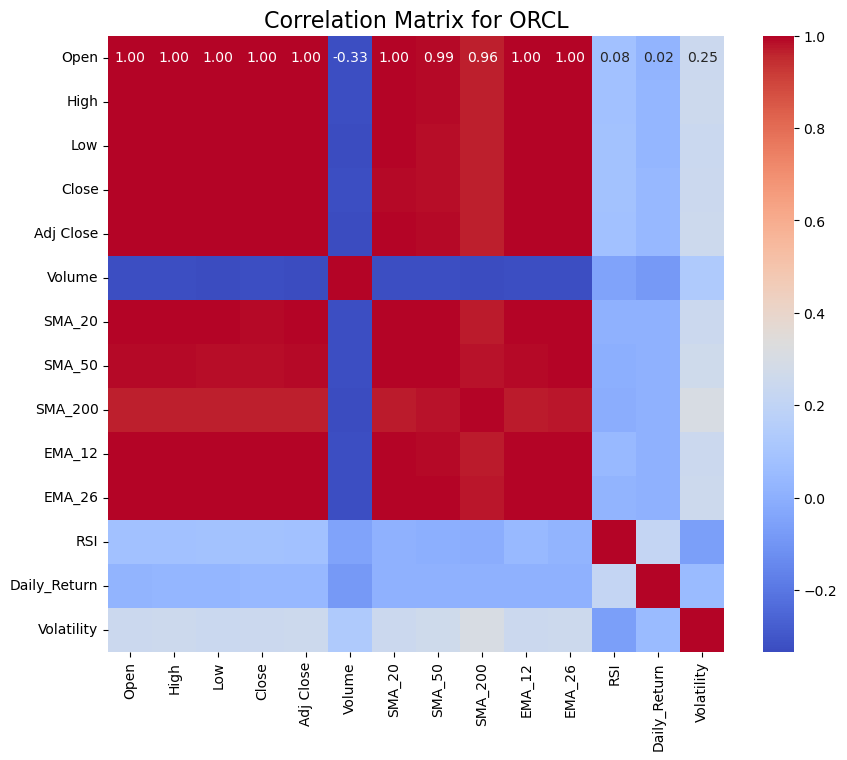

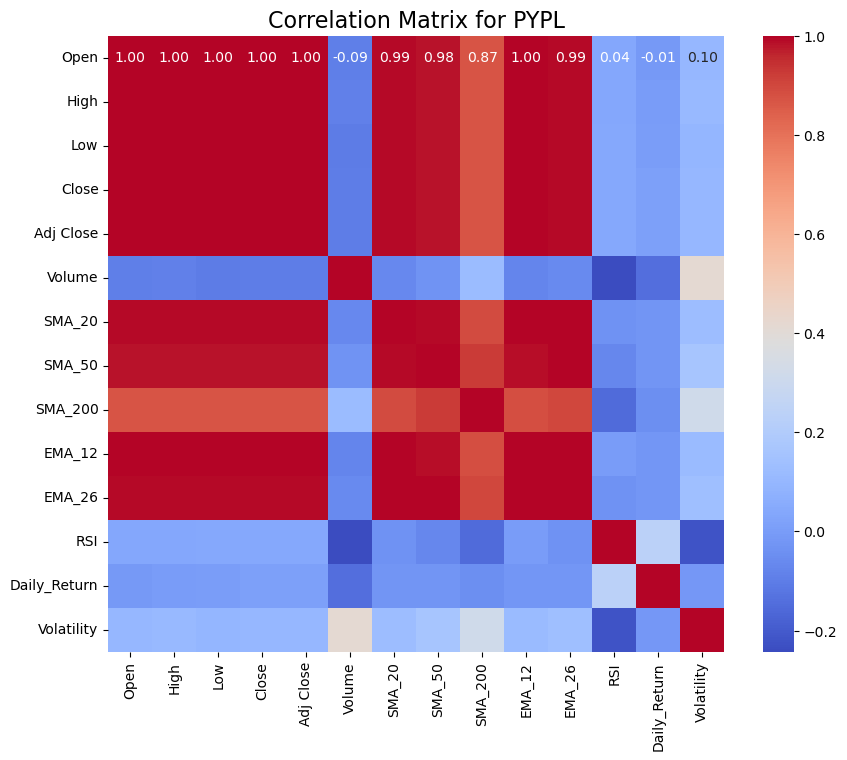

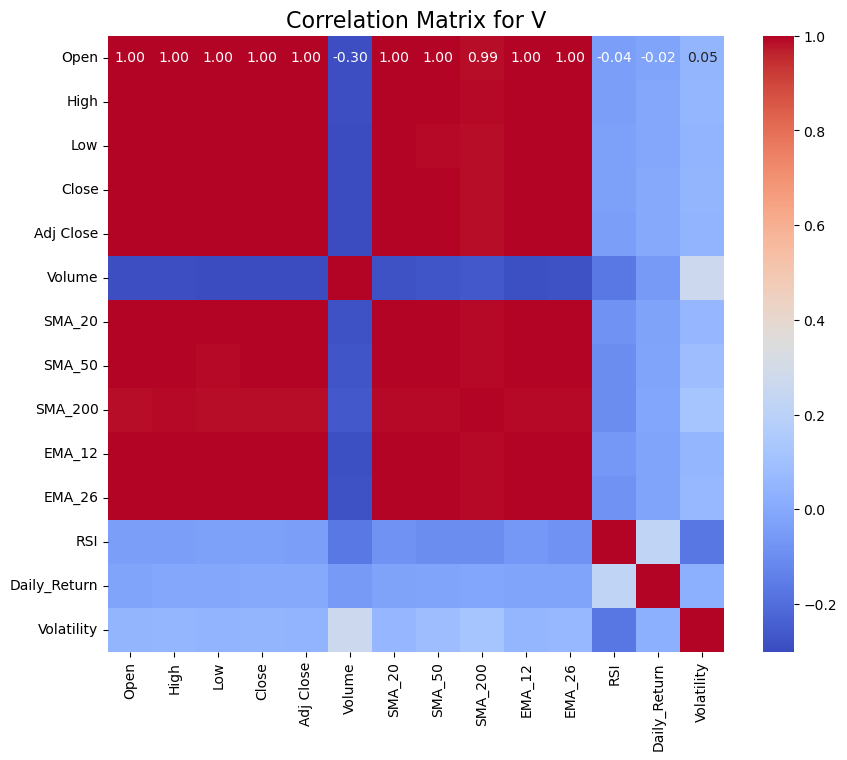

In [67]:
# Select the relevant features
features = ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume' ,'SMA_20', 'SMA_50', 'SMA_200', 'EMA_12', 'EMA_26', 'RSI', 'Daily_Return', 'Volatility']

# Group the data by ticker
tickers = finaldf['Ticker'].unique()

# Loop over each ticker and compute the correlation matrix
for ticker in tickers:
    # Filter the data for the current ticker
    ticker_data = finaldf[finaldf['Ticker'] == ticker][features]
    
    # Calculate the correlation matrix
    correlation_matrix = ticker_data.corr()

    # Set up the matplotlib figure
    plt.figure(figsize=(10, 8))

    # Create a heatmap using Seaborn
    sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True, cbar=True,
                xticklabels=features, yticklabels=features)

    # Set the title
    plt.title(f'Correlation Matrix for {ticker}', fontsize=16)

    # Show the plot
    plt.show()


- After some analysing, we realised for all the Tickers, the features 'Open', 'High', 'Low', 'Close', 'Adj Close', 'SMA_20', 'SMA_50', 'SMA_200', 'EMA_12', 'EMA_26' had the highest correlation to the 'Close' price.
- As such, we will be using those features to train our models.

##### 1) Linear Regression
(Norris, 2022)

In [68]:
# Define features (the indicators you want to use) and the target variable
features = ['Open', 'High', 'Low', 'Close', 'Adj Close', 'SMA_20', 'SMA_50', 'SMA_200', 'EMA_12', 'EMA_26']
target = 'Close'

# Get the unique stock tickers
stock_list = finaldf['Ticker'].unique()

In [69]:
# Dictionary to store results
results = {}

# Loop through each stock symbol
for stock in stock_list:
    # Filter the data for the current stock
    stock_data = finaldf[finaldf['Ticker'] == stock]
    
    # Split the dataset into training (all data except the last year) and testing (last year)
    train_data = stock_data.iloc[:-252]  # Previous years' data
    test_data = stock_data.iloc[-252:]    # Last year of data

    # Define features and target for training and testing
    X_train = train_data[features]
    y_train = train_data[target]
    X_test = test_data[features]
    y_test = test_data[target]
    
    # Initialize the Linear Regression model
    model = LinearRegression()
    
    # Train the model
    model.fit(X_train, y_train)
    
    # Make predictions on the test data
    y_pred = model.predict(X_test)
    
    # Calculate Mean Squared Error (MSE)
    mse = mean_squared_error(y_test, y_pred)
    
    # Calculate Root Mean Squared Error (RMSE)
    root_mse = np.sqrt(mse)

    # Calculate the percentage difference between actual and predicted prices
    percentage_diff = np.mean(np.abs((y_test.values - y_pred) / y_test.values)) * 100
    
    # Store the MSE, RMSE, and percentage difference in the results dictionary
    results[stock] = {
        'MSE': mse,
        'RMSE': root_mse,
        'Percentage Difference': percentage_diff,
        'Actual vs Predicted': pd.DataFrame({'Actual': y_test.values, 'Predicted': y_pred}),
        'Model': model  # Store the trained model directly here
    }

In [70]:
# Create an interactive plot
fig = make_subplots(rows=1, cols=1)

# Add traces for each stock
for stock, metrics in results.items():
    # Plot the actual prices as solid lines
    fig.add_trace(
        go.Scatter(
            x=np.arange(len(metrics['Actual vs Predicted'])),
            y=metrics['Actual vs Predicted']['Actual'],
            mode='lines',
            name=f'Actual Prices - {stock}',
            visible='legendonly'  # Initially hide all traces
        )
    )
    
    # Plot the predicted prices as dotted lines
    fig.add_trace(
        go.Scatter(
            x=np.arange(len(metrics['Actual vs Predicted'])),
            y=metrics['Actual vs Predicted']['Predicted'],
            mode='lines',
            name=f'Predicted Prices - {stock}',
            visible='legendonly',  # Initially hide all traces
            line=dict(dash='dot')  # This makes the line dotted
        )
    )

# Create dropdown menu to select stock
stock_buttons = [
    {
        'label': stock,
        'method': 'update',
        'args': [{'visible': [stock in trace.name for trace in fig.data]}]  # Show only selected stock
    }
    for stock in results.keys()
]

# Add "All" option to show all stocks
stock_buttons.append({
    'label': 'All',
    'method': 'update',
    'args': [{'visible': [True] * len(fig.data)}]  # Show all traces
})

# Update layout with dropdown menu
fig.update_layout(
    title='Stock Price Prediction: Actual vs Predicted',
    xaxis_title='Data Points (Trading Days)',
    yaxis_title='Price',
    updatemenus=[
        {
            'buttons': stock_buttons,
            'direction': 'down',
            'showactive': True,
            'x': 0.1,
            'xanchor': 'left',
            'y': 1.15,
            'yanchor': 'top'
        }
    ]
)

# Show the figure
fig.show()

In [71]:
# MSE values across all tickers
mse_values = {stock: metrics['MSE'] for stock, metrics in results.items()}

# Create a DataFrame for MSE values
error_df = pd.DataFrame({
    'Stock': mse_values.keys(),
    'MSE': mse_values.values()
})
# Plot RMSE values
fig_mse = px.bar(error_df, x='Stock', y='MSE', 
                  title='MSE for each Stock', 
                  labels={'MSE': 'Mean Squared Error'},
                  height=500)

# Calculate the minimum and maximum MSE values
min_mse = error_df['MSE'].min()
max_mse = error_df['MSE'].max()
print('The range of MSE for linear regression is', min_mse, 'to', max_mse)
fig_mse.show()

The range of MSE for linear regression is 2.0054597234951945e-28 to 5.367579149223512e-21


In [72]:
# RMSE values across all tickers
rmse_values = {stock: metrics['RMSE'] for stock, metrics in results.items()}

# Create a DataFrame for RMSE values
error_df = pd.DataFrame({
    'Stock': rmse_values.keys(),
    'RMSE': rmse_values.values()
})
# Plot RMSE values
fig_rmse = px.bar(error_df, x='Stock', y='RMSE', 
                  title='RMSE for each Stock', 
                  labels={'RMSE':'Root Mean Squared Error'},
                  height=500)
# Calculate the minimum and maximum MSE values
min_rmse = error_df['RMSE'].min()
max_rmse = error_df['RMSE'].max()
print('The range of RMSE for linear regression is', min_rmse, 'to', max_rmse)
fig_rmse.show()

The range of RMSE for linear regression is 1.4161425505559794e-14 to 7.326376423050833e-11


In [73]:
# Directory to save the models
models_dir = 'linear_regression_models'
os.makedirs(models_dir, exist_ok=True)

# Save each model in the results dictionary
for stock, metrics in results.items():
    model = metrics['Model']  # Retrieve the trained model from the results dictionary
    model_filename = os.path.join(models_dir, f'{stock}_linear_model.pkl')
    joblib.dump(model, model_filename)
    print(f'Model for {stock} saved as {model_filename}')

Model for AAPL saved as linear_regression_models\AAPL_linear_model.pkl
Model for ACN saved as linear_regression_models\ACN_linear_model.pkl
Model for ADBE saved as linear_regression_models\ADBE_linear_model.pkl
Model for AMZN saved as linear_regression_models\AMZN_linear_model.pkl
Model for AXP saved as linear_regression_models\AXP_linear_model.pkl
Model for C saved as linear_regression_models\C_linear_model.pkl
Model for CRM saved as linear_regression_models\CRM_linear_model.pkl
Model for DIS saved as linear_regression_models\DIS_linear_model.pkl
Model for GOOGL saved as linear_regression_models\GOOGL_linear_model.pkl
Model for INTC saved as linear_regression_models\INTC_linear_model.pkl
Model for JPM saved as linear_regression_models\JPM_linear_model.pkl
Model for MA saved as linear_regression_models\MA_linear_model.pkl
Model for META saved as linear_regression_models\META_linear_model.pkl
Model for MSFT saved as linear_regression_models\MSFT_linear_model.pkl
Model for MU saved as li

##### 2) SARIMAX (Seasonal ARIMA with Exogenous Variables)
(Kobi Dadush, 2022)

In [74]:
data = pd.read_csv('final_dataset.csv')

# Convert 'Date' column to datetime format and set it as index
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)

In [75]:
unique_tickers = data['Ticker'].unique()

# Store predictions and RMSE results
predictions_dict = {}
rmse_dict = {}
mse_dict = {}
models_dict = {}  # Dictionary to store trained models

# Loop over each ticker to train SARIMAX models
for ticker in unique_tickers:
    stock_data = data[data['Ticker'] == ticker]

    # Target variable (Close price)
    endog = stock_data['Close']
    
    # Exogenous variables
    exog = stock_data[['Open', 'High', 'Low', 'Close', 'Adj Close', 'SMA_20', 'SMA_50', 'SMA_200', 'EMA_12', 'EMA_26']]
    
    # Split data into train and test sets (80% train, 20% test)
    train_size = int(len(stock_data) * 0.8)
    train_endog, test_endog = endog[:train_size], endog[train_size:]
    train_exog, test_exog = exog[:train_size], exog[train_size:]
    
    try:
        # Build and fit the SARIMAX model
        sarimax_model = SARIMAX(train_endog, exog=train_exog, order=(1, 1, 1), seasonal_order=(0, 0, 0, 0))
        sarimax_fit = sarimax_model.fit(disp=False)
        
        # Make predictions
        predictions = sarimax_fit.predict(start=len(train_endog), end=len(endog)-1, exog=test_exog)
        
        # Calculate MSE and RMSE
        mse = mean_squared_error(test_endog, predictions)
        rmse = np.sqrt(mse)

        # Store predictions and errors
        predictions_dict[ticker] = pd.DataFrame({
            'Actual': test_endog.values,
            'Predicted': predictions.values
        }, index=test_endog.index)

        rmse_dict[ticker] = rmse
        mse_dict[ticker] = mse

        # Store the trained model
        models_dict[ticker] = sarimax_fit  # Keep the fitted model in a dictionary
        
        print(f"Trained model for {ticker} successfully.")

    except Exception as e:
        print(f"Failed to fit model for {ticker}: {e}")

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-pa

Trained model for AAPL successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



Trained model for ACN successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



Trained model for ADBE successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a support

Trained model for AMZN successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



Trained model for AXP successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



Trained model for C successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



Trained model for CRM successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided

Trained model for DIS successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so w

Trained model for GOOGL successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



Trained model for INTC successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so w

Trained model for JPM successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



Trained model for MA successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



Trained model for META successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



Trained model for MSFT successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a support

Trained model for MU successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so w

Trained model for NFLX successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



Trained model for NVDA successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided

Trained model for ORCL successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



Trained model for PYPL successfully.
Trained model for V successfully.


d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

d:\AppData\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



In [76]:
# Interactive dropdown for selecting stocks to visualize
def plot_with_dropdown():
    fig = make_subplots()

    # Create traces for each stock but make them initially invisible
    for ticker in unique_tickers:
        stock_df = predictions_dict[ticker]
        
        # Actual Prices Line
        fig.add_trace(go.Scatter(x=stock_df.index, y=stock_df['Actual'], 
                                 mode='lines', name=f'{ticker} Actual', visible=False))
        
        # Predicted Prices Line
        fig.add_trace(go.Scatter(x=stock_df.index, y=stock_df['Predicted'], 
                                 mode='lines', name=f'{ticker} Predicted',line=dict(color='red', dash='dot'), visible=False))

    # Show the first stock (AAPL) as default
    fig.data[0].visible = True  # AAPL Actual
    fig.data[1].visible = True  # AAPL Predicted

    # Create dropdown buttons
    dropdown_buttons = []
    for i, ticker in enumerate(unique_tickers):
        button = dict(
            label=ticker,
            method='update',
            args=[{'visible': [False] * len(fig.data)},  # Set all traces to invisible first
                  {'title': f'Actual vs Predicted Prices for {ticker}'}]
        )
        
        # Make the actual and predicted traces for the selected ticker visible
        button['args'][0]['visible'][i*2] = True  # Actual line for selected stock
        button['args'][0]['visible'][i*2 + 1] = True  # Predicted line for selected stock
        
        dropdown_buttons.append(button)

    # Update layout with dropdown menu
    fig.update_layout(updatemenus=[{
        'buttons': dropdown_buttons,
        'direction': 'down',
        'showactive': True,
    }])

    # Set default title
    fig.update_layout(title='Actual vs Predicted Prices (SARIMAX)', xaxis_title='Date', yaxis_title='Price')

    fig.show()

# Call the function to generate the plot
plot_with_dropdown()


In [77]:
# MSE values across all tickers
mse_df = pd.DataFrame({
    'Ticker': list(mse_dict.keys()),
    'MSE': list(mse_dict.values())
})

# Plot RMSE values
fig_mse = px.bar(mse_df, x='Ticker', y='MSE', 
                  title='MSE for each Stock', 
                  labels={'MSE': 'Mean Squared Error'},
                  height=500)

# Calculate the minimum and maximum MSE values
min_mse = mse_df['MSE'].min()
max_mse = mse_df['MSE'].max()
print('The range of MSE for SARIMAX model is', min_mse, 'to', max_mse)

fig_mse.show()

The range of MSE for SARIMAX model is 2.8204084913958963e-27 to 5.367888271874468e-08


In [78]:
# RMSE values across all tickers
rmse_df = pd.DataFrame({
    'Ticker': list(rmse_dict.keys()),
    'RMSE': list(rmse_dict.values())
})

# Plot RMSE values
fig_rmse = px.bar(rmse_df, x='Ticker', y='RMSE', 
                  title='RMSE for each Stock', 
                  labels={'RMSE': 'Root Mean Squared Error'},
                  height=500)

# Calculate the minimum and maximum MSE values
min_rmse = rmse_df['RMSE'].min()
max_rmse = rmse_df['RMSE'].max()
print('The range of RMSE for SARIMAX model is', min_rmse, 'to', max_rmse)

fig_rmse.show()

The range of RMSE for SARIMAX model is 5.310751821913632e-14 to 0.00023168703614735261


In [79]:
# Create a directory to store the models
os.makedirs('sarimax_models', exist_ok=True)

# Save the trained models for each ticker
for ticker, model in models_dict.items():
    try:
        model_path = f'sarimax_models/{ticker}_sarimax_model.pkl'
        joblib.dump(model, model_path)
        print(f"Saved model for {ticker} at {model_path}")
    except Exception as e:
        print(f"Failed to save model for {ticker}: {e}")

Saved model for AAPL at sarimax_models/AAPL_sarimax_model.pkl
Saved model for ACN at sarimax_models/ACN_sarimax_model.pkl
Saved model for ADBE at sarimax_models/ADBE_sarimax_model.pkl
Saved model for AMZN at sarimax_models/AMZN_sarimax_model.pkl
Saved model for AXP at sarimax_models/AXP_sarimax_model.pkl
Saved model for C at sarimax_models/C_sarimax_model.pkl
Saved model for CRM at sarimax_models/CRM_sarimax_model.pkl
Saved model for DIS at sarimax_models/DIS_sarimax_model.pkl
Saved model for GOOGL at sarimax_models/GOOGL_sarimax_model.pkl
Saved model for INTC at sarimax_models/INTC_sarimax_model.pkl
Saved model for JPM at sarimax_models/JPM_sarimax_model.pkl
Saved model for MA at sarimax_models/MA_sarimax_model.pkl
Saved model for META at sarimax_models/META_sarimax_model.pkl
Saved model for MSFT at sarimax_models/MSFT_sarimax_model.pkl
Saved model for MU at sarimax_models/MU_sarimax_model.pkl
Saved model for NFLX at sarimax_models/NFLX_sarimax_model.pkl
Saved model for NVDA at sarima

##### 3) Long Short-Term Memory

(Kobi Dadush, 2022)



In [80]:
# Load data
df = pd.read_csv('final_dataset.csv')

# Define features and target
features = ['Open', 'High', 'Low', 'Close', 'Adj Close', 'SMA_20', 'SMA_50', 'SMA_200', 'EMA_12', 'EMA_26']
target = 'Close'

# Function to build the LSTM model
def build_lstm_model(input_shape):
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=input_shape))
    model.add(Dropout(0.2))
    model.add(LSTM(units=50))
    model.add(Dropout(0.2))
    model.add(Dense(units=1))  # Output layer
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

# Initialize a dictionary to store models, results, MSE, and RMSE
models = {}
results = {}
mse_dict = {}
rmse_dict = {}

# Iterate over each ticker
for ticker in df['Ticker'].unique():
    print(f"Training LSTM for {ticker}...")

    # Filter data for the current ticker
    stock_data = df[df['Ticker'] == ticker]
    
    # Sort data by date
    stock_data = stock_data.sort_values('Date')
    
    # Select features and target (Close price)
    stock_data = stock_data[features]
    
    # Drop any missing values
    stock_data = stock_data.dropna()

    # Normalize the features using MinMaxScaler
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(stock_data)
    
    # Prepare the dataset for LSTM
    X = []
    y = []

    window_size = 60  # Use the last 60 days to predict the next value
    for i in range(window_size, len(scaled_data)):
        X.append(scaled_data[i-window_size:i])
        y.append(scaled_data[i, features.index(target)])  # Close price is the target

    X, y = np.array(X), np.array(y)

    # Split the data into training and testing sets (80% training, 20% testing)
    split_ratio = 0.8
    train_size = int(len(X) * split_ratio)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]

    # Build and train the model
    model = build_lstm_model((X_train.shape[1], X_train.shape[2]))
    history = model.fit(X_train, y_train, epochs=10, batch_size=64, validation_data=(X_test, y_test))
    
    # Evaluate the model
    y_pred = model.predict(X_test)  # Make predictions on test data
    mse = mean_squared_error(y_test, y_pred)  # Calculate MSE
    rmse = np.sqrt(mse)  # Calculate RMSE
    
    # Store the results
    models[ticker] = model
    results[ticker] = {
        'Test Loss': history.history['val_loss'][-1],  # Final validation loss
        'History': history,
        'X_test': X_test,  # Store test inputs
        'y_test': y_test,   # Store test actual values (target)
        'Predictions': y_pred,  # Store predictions
    }
    mse_dict[ticker] = mse  # Store MSE
    rmse_dict[ticker] = rmse  # Store RMSE

Training LSTM for AAPL...


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 28s 93ms/step - loss: 0.0200 - val_loss: 0.0046
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - loss: 0.0014 - val_loss: 0.0037
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - loss: 0.0012 - val_loss: 0.0035
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - loss: 0.0011 - val_loss: 0.0016
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - loss: 0.0010 - val_loss: 0.0025
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 7.8881e-04 - val_loss: 0.0052
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - loss: 9.9220e-04 - val_loss: 0.0043
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 95ms/step - loss: 9.4744e-04 - val_loss: 0.0012
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - loss: 7.1136e-04 - val_loss: 0.0023
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 7.1007e-04 - val_loss: 0.0018
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
Training LSTM for ACN...


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 10s 73ms/step - loss: 0.0438 - val_loss: 0.0024
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - loss: 0.0026 - val_loss: 0.0040
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0023 - val_loss: 0.0019
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0018 - val_loss: 0.0018
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0018 - val_loss: 0.0016
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - loss: 0.0012 - val_loss: 0.0018
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 63ms/step - loss: 0.0014 - val_loss: 0.0015
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - loss: 0.0014 - val_loss: 0.0021
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - loss: 0.0011 - val_loss: 0.0011
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
Training LSTM for ADBE...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 86ms/step - loss: 0.0324 - val_loss: 0.0057
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 76ms/step - loss: 0.0031 - val_loss: 0.0028
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - loss: 0.0026 - val_loss: 0.0033
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0020 - val_loss: 0.0018
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0017 - val_loss: 0.0029
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0016 - val_loss: 0.0015
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0015 - val_loss: 0.0014
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0014 - val_loss: 0.0017
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0015 - val_loss: 0.0014
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 77ms/step - loss: 0.0014 - val_loss: 0.0022
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step
Training LSTM for AMZN...


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 119s 118ms/step - loss: 0.0414 - val_loss: 0.0041
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step - loss: 0.0040 - val_loss: 0.0023
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 101ms/step - loss: 0.0030 - val_loss: 0.0018
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 102ms/step - loss: 0.0027 - val_loss: 0.0015
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 93ms/step - loss: 0.0024 - val_loss: 0.0014
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step - loss: 0.0020 - val_loss: 0.0022
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 94ms/step - loss: 0.0021 - val_loss: 0.0011
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 95ms/step - loss: 0.0021 - val_loss: 0.0016
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step - loss: 0.0018 - val_loss: 0.0011
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step - loss: 0.0016 - val_loss: 0.0015
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step
Training LSTM for AXP...


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 10s 105ms/step - loss: 0.0229 - val_loss: 0.0096
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 95ms/step - loss: 0.0018 - val_loss: 0.0026
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 95ms/step - loss: 0.0013 - val_loss: 0.0018
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - loss: 0.0012 - val_loss: 0.0027
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - loss: 0.0012 - val_loss: 0.0023
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - loss: 0.0012 - val_loss: 0.0016
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - loss: 0.0010 - val_loss: 0.0026
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - loss: 9.2831e-04 - val_loss: 0.0014
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step
Training LSTM for C...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 99ms/step - loss: 0.0505 - val_loss: 0.0026
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - loss: 0.0086 - val_loss: 0.0033
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0063 - val_loss: 0.0045
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - loss: 0.0059 - val_loss: 0.0032
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - loss: 0.0050 - val_loss: 0.0035
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - loss: 0.0046 - val_loss: 0.0024
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - loss: 0.0045 - val_loss: 0.0023
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - loss: 0.0046 - val_loss: 0.0030
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - loss: 0.0042 - val_loss: 0.0016
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - loss: 0.0044 - val_loss: 0.0024
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step
Training LSTM for CRM...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 9s 101ms/step - loss: 0.0511 - val_loss: 0.0064
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 0.0045 - val_loss: 0.0018
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - loss: 0.0031 - val_loss: 0.0017
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0022 - val_loss: 0.0014
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - loss: 0.0022 - val_loss: 0.0014
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step - loss: 0.0019 - val_loss: 0.0012
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 0.0017 - val_loss: 0.0011
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0017 - val_loss: 0.0012
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0017 - val_loss: 0.0011
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0018 - val_loss: 0.0015
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step
Training LSTM for DIS...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 97ms/step - loss: 0.0202 - val_loss: 0.0014
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0043 - val_loss: 0.0015
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0036 - val_loss: 0.0011
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.0028 - val_loss: 9.4838e-04
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0025 - val_loss: 9.7712e-04
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0027 - val_loss: 0.0012
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0026 - val_loss: 9.6023e-04
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0021 - val_loss: 8.1692e-04
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0023 - val_loss: 7.2682e-04
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 0.0021 - val_loss: 6.7725e-04
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step
Training LSTM for GOOGL...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 99ms/step - loss: 0.0249 - val_loss: 0.0036
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0018 - val_loss: 0.0022
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 9.6920e-04 - val_loss: 0.0015
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - loss: 0.0014 - val_loss: 9.0661e-04
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.0011 - val_loss: 9.7538e-04
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 9.5336e-04 - val_loss: 0.0011
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 7.9097e-04 - val_loss: 0.0010
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step
Training LSTM for INTC...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 97ms/step - loss: 0.0528 - val_loss: 0.0054
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0061 - val_loss: 0.0041
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 0.0047 - val_loss: 0.0030
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0046 - val_loss: 0.0032
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0036 - val_loss: 0.0028
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0039 - val_loss: 0.0026
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0040 - val_loss: 0.0033
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0034 - val_loss: 0.0021
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 5s 64ms/step - loss: 0.0034 - val_loss: 0.0018
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - loss: 0.0031 - val_loss: 0.0026
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step
Training LSTM for JPM...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - loss: 0.0135 - val_loss: 0.0028
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0028 - val_loss: 0.0027
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.0018 - val_loss: 9.9356e-04
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0015 - val_loss: 0.0010
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0015 - val_loss: 0.0014
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.0015 - val_loss: 0.0015
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0013 - val_loss: 8.7347e-04
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0015 - val_loss: 7.8789e-04
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0011 - val_loss: 0.0019
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0012 - val_loss: 8.3025e-04
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step
Training LSTM for MA...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - loss: 0.0441 - val_loss: 0.0110
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.0030 - val_loss: 0.0043
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0027 - val_loss: 0.0023
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 76ms/step - loss: 0.0027 - val_loss: 0.0017
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0019 - val_loss: 0.0013
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 77ms/step - loss: 0.0019 - val_loss: 0.0035
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.0018 - val_loss: 0.0018
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0015 - val_loss: 0.0016
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0015 - val_loss: 0.0014
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0014 - val_loss: 0.0016
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
Training LSTM for META...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - loss: 0.0162 - val_loss: 0.0135
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 76ms/step - loss: 0.0019 - val_loss: 0.0033
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 76ms/step - loss: 0.0012 - val_loss: 0.0021
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - loss: 0.0011 - val_loss: 0.0022
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 0.0012 - val_loss: 9.7940e-04
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 0.0011 - val_loss: 0.0035
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 9.7145e-04 - val_loss: 9.5898e-04
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 76ms/step - loss: 8.8535e-04 - val_loss: 0.0021
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 9.3165e-04 - val_loss: 9.9967e-04
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
Training LSTM for MSFT...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - loss: 0.0203 - val_loss: 0.0082
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 77ms/step - loss: 0.0012 - val_loss: 0.0032
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 0.0012 - val_loss: 0.0027
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 8.7104e-04 - val_loss: 0.0016
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 8.5099e-04 - val_loss: 0.0011
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 8.7134e-04 - val_loss: 0.0013
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 8.4157e-04 - val_loss: 8.4055e-04
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 7.7985e-04 - val_loss: 7.1879e-04
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 8.7810e-04 - val_loss: 6.9354e-04
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 7.0818e-04 - val_loss: 7.3805e-04
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
Training LSTM for MU...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 9s 88ms/step - loss: 0.0113 - val_loss: 0.0034
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 76ms/step - loss: 0.0015 - val_loss: 0.0023
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 0.0013 - val_loss: 0.0019
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 9.9247e-04 - val_loss: 0.0019
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 9.7083e-04 - val_loss: 0.0017
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 9.4158e-04 - val_loss: 0.0014
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 8.5445e-04 - val_loss: 0.0016
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 8.6885e-04 - val_loss: 0.0012
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 8.1198e-04 - val_loss: 0.0011
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
Training LSTM for NFLX...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 86ms/step - loss: 0.0407 - val_loss: 0.0060
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 0.0035 - val_loss: 0.0026
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0029 - val_loss: 0.0012
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 0.0027 - val_loss: 0.0012
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0024 - val_loss: 0.0013
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 0.0023 - val_loss: 0.0012
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0021 - val_loss: 0.0012
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0019 - val_loss: 9.9446e-04
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 0.0020 - val_loss: 9.3950e-04
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - loss: 0.0017 - val_loss: 9.2708e-04
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
Training LSTM for NVDA...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step - loss: 0.0014 - val_loss: 0.0206
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - loss: 1.2043e-04 - val_loss: 0.0119
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 1.0382e-04 - val_loss: 0.0087
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 7.6676e-05 - val_loss: 0.0056
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - loss: 7.1378e-05 - val_loss: 0.0071
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 9.4389e-05 - val_loss: 0.0057
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 7.8234e-05 - val_loss: 0.0042
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - loss: 7.5769e-05 - val_loss: 0.0044
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - loss: 6.8457e-05 - val_loss: 0.0031
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - loss: 5.9302e-05 - val_loss: 0.0053
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
Training LSTM for ORCL...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - loss: 0.0040 - val_loss: 0.0148
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 0.0013 - val_loss: 0.0040
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - loss: 7.8965e-04 - val_loss: 0.0026
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - loss: 7.6046e-04 - val_loss: 0.0047
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 6.6042e-04 - val_loss: 0.0025
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - loss: 6.9464e-04 - val_loss: 0.0033
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 5.8027e-04 - val_loss: 0.0035
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - loss: 5.3873e-04 - val_loss: 0.0018
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 6.0217e-04 - val_loss: 0.0022
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 5.7481e-04 - val_loss: 0.0027
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
Training LSTM for PYPL...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



29/29 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - loss: 0.0280 - val_loss: 2.3421e-04
Epoch 2/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - loss: 0.0034 - val_loss: 1.6399e-04
Epoch 3/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - loss: 0.0028 - val_loss: 1.6617e-04
Epoch 4/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - loss: 0.0028 - val_loss: 1.4996e-04
Epoch 5/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0022 - val_loss: 1.4863e-04
Epoch 6/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - loss: 0.0022 - val_loss: 1.3472e-04
Epoch 7/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - loss: 0.0020 - val_loss: 1.4033e-04
Epoch 8/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0019 - val_loss: 1.8448e-04
Epoch 9/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - loss: 0.0019 - val_loss: 1.5093e-04
Epoch 10/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - loss: 0.0020 - val_loss: 1.3788e-04
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step
Training LSTM for V...
Epoch 1/10


d:\AppData\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - loss: 0.0306 - val_loss: 0.0089
Epoch 2/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - loss: 0.0025 - val_loss: 0.0033
Epoch 3/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - loss: 0.0023 - val_loss: 0.0011
Epoch 4/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - loss: 0.0019 - val_loss: 0.0020
Epoch 5/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 69ms/step - loss: 0.0018 - val_loss: 0.0026
Epoch 6/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - loss: 0.0017 - val_loss: 0.0018
Epoch 7/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0018 - val_loss: 0.0015
Epoch 8/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 69ms/step - loss: 0.0015 - val_loss: 7.6534e-04
Epoch 9/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 69ms/step - loss: 0.0017 - val_loss: 9.6187e-04
Epoch 10/10
36/36 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - loss: 0.0016 - val_loss: 0.0023
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step


In [81]:
# Function to plot actual vs predicted prices for all tickers with a dropdown
def plot_actual_vs_predicted_all():
    # Create a plotly figure
    fig = go.Figure()

    # Loop through each ticker to add traces
    for ticker in results.keys():
        y_test = results[ticker]['y_test']  # Actual closing prices (test data)
        X_test = results[ticker]['X_test']  # Test features (inputs)
        
        # Use the model to predict the prices
        y_pred = models[ticker].predict(X_test)

        # Add actual prices trace
        fig.add_trace(go.Scatter(x=list(range(len(y_test))), y=y_test, mode='lines', name=f'Actual Prices ({ticker})', visible='legendonly'))

        # Add predicted prices trace
        fig.add_trace(go.Scatter(x=list(range(len(y_pred))), y=y_pred.flatten(), mode='lines', name=f'Predicted Prices ({ticker})', line=dict(dash='dash'), visible='legendonly'))

    # Update layout with dropdown menu
    fig.update_layout(
        title='Actual vs Predicted Prices for Stocks',
        xaxis_title='Time (Trading Days)',
        yaxis_title='Price',
        legend_title='Legend',
        hovermode='x unified',
        updatemenus=[{
            'buttons': [
                {
                    'method': 'update',
                    'label': ticker,
                    'args': [
                        {'visible': [ticker in trace.name for trace in fig.data]},
                        {'title': f'{ticker}: Actual vs Predicted Prices (LSTM)'}
                    ]
                } for ticker in results.keys()
            ],
            'direction': 'down',
            'showactive': True,
        }]
    )

    # Show the plot
    fig.show()

# Call the function to plot all tickers
plot_actual_vs_predicted_all()

18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


In [82]:
# MSE values across all tickers
mse_df = pd.DataFrame({
    'Ticker': list(mse_dict.keys()),
    'MSE': list(mse_dict.values())
})

# Plot MSE values for LSTM model
fig_mse = px.bar(mse_df, x='Ticker', y='MSE', 
                  title='MSE for each Stock (LSTM Model)', 
                  labels={'MSE': 'Mean Squared Error'},
                  height=500)

# Calculate the minimum and maximum RMSE values
min_mse = mse_df['MSE'].min()
max_mse = mse_df['MSE'].max()
print('The range of MSE for LSTM model is', min_mse, 'to', max_mse)

# Show the plot
fig_mse.show()

The range of MSE for LSTM model is 0.0001378750977761523 to 0.005278471000198144


In [83]:
# RMSE values across all tickers
rmse_df = pd.DataFrame({
    'Ticker': list(rmse_dict.keys()),
    'RMSE': list(rmse_dict.values())
})

# Plot RMSE values for LSTM model
fig_rmse = px.bar(rmse_df, x='Ticker', y='RMSE', 
                  title='RMSE for each Stock (LSTM Model)', 
                  labels={'RMSE': 'Root Mean Squared Error'},
                  height=500)

# Calculate the minimum and maximum RMSE values
min_rmse = rmse_df['RMSE'].min()
max_rmse = rmse_df['RMSE'].max()
print('The range of RMSE for LSTM model is', min_rmse, 'to', max_rmse)

# Show the plot
fig_rmse.show()

The range of RMSE for LSTM model is 0.011742022729332127 to 0.07265308665292992


In [84]:
# Create a folder to save the models if it doesn't exist
save_dir = 'lstm_models'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

# Function to save the model for each ticker
def save_lstm_model(model, ticker):
    model_path = os.path.join(save_dir, f"{ticker}_lstm_model.h5")
    model.save(model_path)
    print(f"Model for {ticker} saved to {model_path}")

# After training each model, save it
for ticker in df['Ticker'].unique():
    save_lstm_model(models[ticker], ticker)

Model for AAPL saved to lstm_models\AAPL_lstm_model.h5
Model for ACN saved to lstm_models\ACN_lstm_model.h5


Model for ADBE saved to lstm_models\ADBE_lstm_model.h5


Model for AMZN saved to lstm_models\AMZN_lstm_model.h5
Model for AXP saved to lstm_models\AXP_lstm_model.h5


Model for C saved to lstm_models\C_lstm_model.h5
Model for CRM saved to lstm_models\CRM_lstm_model.h5


Model for DIS saved to lstm_models\DIS_lstm_model.h5


Model for GOOGL saved to lstm_models\GOOGL_lstm_model.h5


Model for INTC saved to lstm_models\INTC_lstm_model.h5


Model for JPM saved to lstm_models\JPM_lstm_model.h5
Model for MA saved to lstm_models\MA_lstm_model.h5


Model for META saved to lstm_models\META_lstm_model.h5


Model for MSFT saved to lstm_models\MSFT_lstm_model.h5
Model for MU saved to lstm_models\MU_lstm_model.h5


Model for NFLX saved to lstm_models\NFLX_lstm_model.h5


Model for NVDA saved to lstm_models\NVDA_lstm_model.h5
Model for ORCL saved to lstm_models\ORCL_lstm_model.h5


Model for PYPL saved to lstm_models\PYPL_lstm_model.h5
Model for V saved to lstm_models\V_lstm_model.h5


### 7) Conclusion

- Our stocks data for the past 10 years from 01/01/2013 to 31/08/2024 have a total of 2936 rows for each of the 20 stocks.
- The general trend of the stocks prices are increasing through the years.
- After modelling and predicting on our test datasets, we decided to use LSTM for our front-end predictions as it was the least overfitted.

### 8) References

Chen, J. (2021). Technical Indicator Definition. [online] Investopedia. Available at: https://www.investopedia.com/terms/t/technicalindicator.asp.

Kobi Dadush (2022). Stock Price Prediction with LSTM and SARIMAX Model - Kobi Dadush - Medium. [online] Medium. Available at: https://medium.com/@baget1/stock-price-prediction-with-lstm-and-sarimax-model-f0718d76749a [Accessed 25 Sep. 2024].

Norris, E. (2022). The Linear Regression of Time and Price. [online] Investopedia. Available at: https://www.investopedia.com/articles/trading/09/linear-regression-time-price.asp.

Sujatha Mudadla (2024). What is Forward and Backward fillling of Imputation in Exploratory Data Analysis (EDA)? [online] Medium. Available at: https://medium.com/@sujathamudadla1213/what-is-forward-and-backward-fillling-of-imputation-in-exploratory-data-analysis-eda-74ec33aca4bd#:~:text=Backward%20Filling%20(BFill)%3A [Accessed 25 Sep. 2024].